Following LDA Model Tutorial on GenSim
https://radimrehurek.com/gensim/auto_examples/tutorials/run_lda.html#sphx-glr-auto-examples-tutorials-run-lda-py

In [1]:
TED_TALK_TRANSCRIPTIONS_FILE_PATH = '../datasets/TEDLIUM_release-3/data/raw'

In [16]:
transcription_files = os.listdir(TED_TALK_TRANSCRIPTIONS_FILE_PATH)


transcriptions = []
for filename in transcription_files:
    with open(f'{TED_TALK_TRANSCRIPTIONS_FILE_PATH}/{filename}', 'r') as fildes:
        curr_transcription = fildes.read()
        transcriptions.append(curr_transcription)

print('Num transcriptions:', len(transcriptions))

Num transcriptions: 2351


In [17]:
# Pre-processing and vectorizing
# Tokenizing documents
from nltk.tokenize import RegexpTokenizer

docs = transcriptions

# Splitting documents into tokens
tokenizer = RegexpTokenizer(r'\w+')
for idx in range(len(docs)):
    docs[idx] = docs[idx].lower()  # Convert to lowercase.
    docs[idx] = tokenizer.tokenize(docs[idx])  # Split into words.

# Remove numbers, but not words that contain numbers.
docs = [[token for token in doc if not token.isnumeric()] for doc in docs]

# Remove words that are only one character.
docs = [[token for token in doc if len(token) > 1] for doc in docs]

In [18]:
# Remove 'unk' token
docs = [[token for token in doc if token != 'unk'] for doc in docs]

In [20]:
import nltk
import ssl

try:
    _create_unverified_https_context = ssl._create_unverified_context
except AttributeError:
    pass
else:
    ssl._create_default_https_context = _create_unverified_https_context

nltk.download('wordnet')

[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/alprielse/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [21]:
# Lemmatize the documents.
from nltk.stem.wordnet import WordNetLemmatizer

lemmatizer = WordNetLemmatizer()
docs = [[lemmatizer.lemmatize(token) for token in doc] for doc in docs]

In [22]:
# Compute bi-grams
from gensim.models import Phrases

# Add bigram and trigrams to docs (only ones that appear 20 times or more)
bigram = Phrases(docs, min_count=20)
for idx in range(len(docs)):
    for token in bigram[docs[idx]]:
        if '_' in token:
            # Token is a bigram, add to document.
            docs[idx].append(token)


/Users/alprielse/src/lab5/env-lab5/lib/python3.8/site-packages/gensim/similarities/__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


In [23]:
# Remove rare and common tokens.
from gensim.corpora import Dictionary

# Create a dictionary representation of the documents.
dictionary = Dictionary(docs)

# Filter out words that occur less than 20 documents, or more than 50% of the documents.
dictionary.filter_extremes(no_below=5, no_above=0.5)

In [24]:
corpus = [dictionary.doc2bow(doc) for doc in docs]

In [25]:
print('Number of unique tokens: %d' % len(dictionary.items()))
print('Number of documents: %d' % len(corpus))

Number of unique tokens: 16784
Number of documents: 2351


In [30]:
# Train LDA model.
from gensim.models import LdaModel

def train_lda_model(num_topics=10):
    # Set training parameters.
    chunksize = 2000
    passes = 20
    iterations = 400
    eval_every = None  # Don't evaluate model perplexity, takes too much time.

    # Make a index to word dictionary.
    temp = dictionary[0]  # This is only to "load" the dictionary.
    id2word = dictionary.id2token

    model = LdaModel(
        corpus=corpus,
        id2word=id2word,
        chunksize=chunksize,
        alpha='auto',
        eta='auto',
        iterations=iterations,
        num_topics=num_topics,
        passes=passes,
        eval_every=eval_every
    )

    top_topics = model.top_topics(corpus) #, num_words=20)

    # Average topic coherence is the sum of topic coherences of all topics, divided by the number of topics.
    avg_topic_coherence = sum([t[1] for t in top_topics]) / num_topics
    print(f'Average topic coherence: {avg_topic_coherence} for num_topics = {num_topics}')

    return model, num_topics, avg_topic_coherence

In [31]:
X = [10, 20, 30, 40, 50, 60, 70, 80, 100]
Y = [x[2] for x in map(train_lda_model, X)]

Average topic coherence: -1.2096728653957562 for num_topics = 10
Average topic coherence: -1.3840048654295394 for num_topics = 20
Average topic coherence: -1.802720013945012 for num_topics = 30
Average topic coherence: -2.1173395692494905 for num_topics = 40
Average topic coherence: -1.9173074244650647 for num_topics = 50
Average topic coherence: -2.087133601839617 for num_topics = 60
Average topic coherence: -1.985056451272037 for num_topics = 70
Average topic coherence: -2.1984103996601805 for num_topics = 80
Average topic coherence: -2.2822573864740257 for num_topics = 100


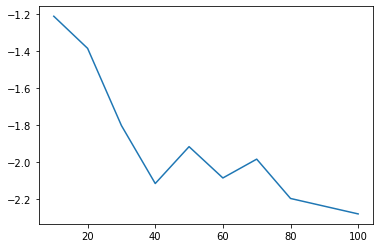

In [32]:
import matplotlib.pyplot as plt

plt.plot(X, Y)

In [33]:
model, _, avg_coherance = train_lda_model(100)

Average topic coherence: -2.0997544090891505 for num_topics = 100


In [37]:
gammas = [model[d] for d in corpus]

In [49]:
import numpy as np

def convert_to_vec(gamma):
    vec = np.zeros((100))
    for topic, weight in gamma:
        vec[topic] = weight
    
    return vec

gammas_as_vec = [convert_to_vec(g) for g in gammas]

In [50]:
from sklearn.manifold import TSNE

embedded = TSNE(n_components=2).fit_transform(gammas_as_vec)
embedded.shape

(2351, 2)

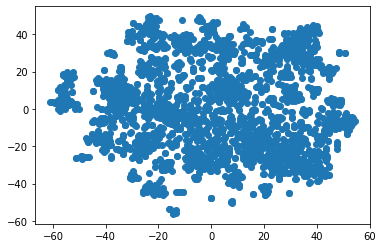

In [51]:
import matplotlib.pyplot as plt

plt.scatter(embedded[:,0], embedded[:, 1])

In [54]:
vecs = np.array(gammas_as_vec)
vecs.shape
np.max(vecs[:,0])

0.6612721681594849

In [102]:
top_topics = model.top_topics(corpus)
def topic_words_list(topic_number):
    return [w for w, j in model.show_topic(topic_number)]

def topic_title(topic_number):
    return f'{topic_number}: ' + ','.join(topic_words_list(topic_number))

def plot_topic(topic_number):
    n, d = vecs.shape

    alphas = vecs[:,topic_number]
    alphas_min = alphas.min()
    alphas_max = alphas.max()
    alphas = (alphas - alphas_min) / (alphas_max - alphas_min)

    # RGB 153, 204, 255
    colors = np.zeros((n, 4))
    colors[:, 0] = np.full(shape=n, fill_value=153/255)
    colors[:, 1] = np.full(shape=n, fill_value=204/255)
    colors[:, 2] = np.full(shape=n, fill_value=255/255)
    colors[:, 3] = alphas

    plt.scatter(embedded[:,0], embedded[:, 1], c=colors)
    plt.title(topic_title(topic_number))
    plt.show()

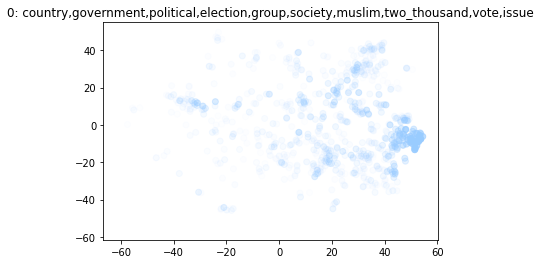

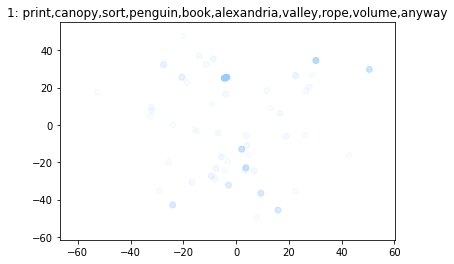

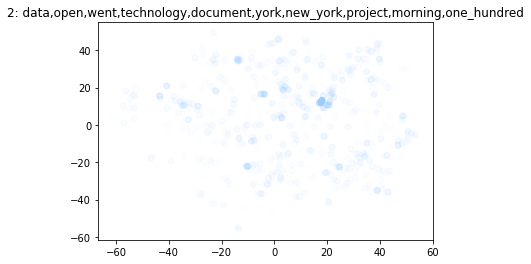

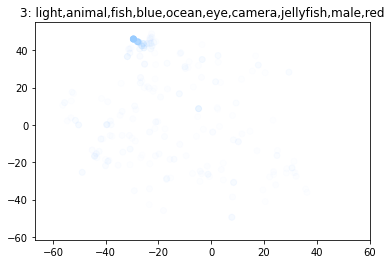

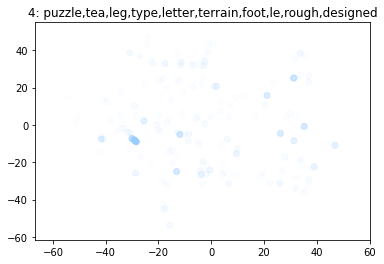

...

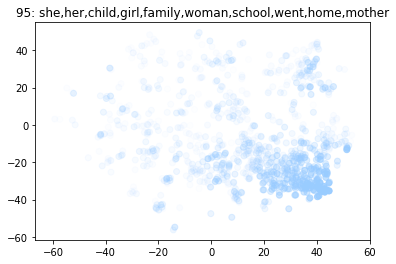

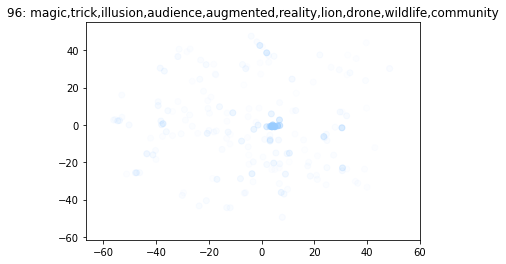

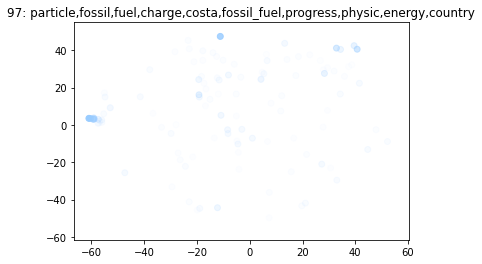

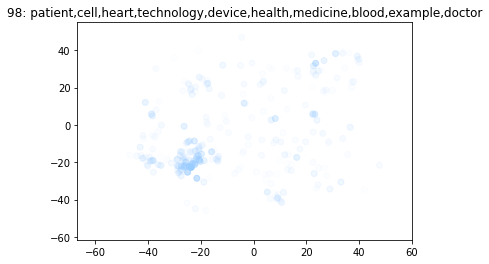

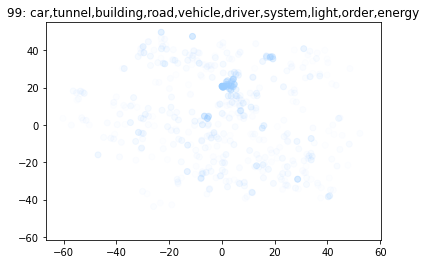

In [106]:
for i in range(100):
    plot_topic(i)